# Installations

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/kaggle/working


In [3]:
from IPython.display import clear_output, Image
# clear_output()

## Virtual Environment and Dependencies

In [4]:
# !pip install virtualenv
# !virtualenv env
# Activate the virtual environment
!source env/bin/activate

In [5]:
import sys
sys.path.append("/kaggle/working/env/lib/python3.10/site-packages")

In [7]:
!env/bin/pip install numpy==1.23.5 torch torchvision comet_ml datatorch
clear_output()

/bin/bash: env/bin/pip: /kaggle/working/env/bin/python: bad interpreter: No such file or directory


In [ ]:
# import shutil
# import os

# # Path to NumPy installation
# numpy_path = '/opt/conda/lib/python3.10/site-packages/numpy'
# numpy_dist_info_path = '/opt/conda/lib/python3.10/site-packages/numpy-1.26.4.dist-info'

# # Remove NumPy files manually if they exist
# if os.path.exists(numpy_path):
#     shutil.rmtree(numpy_path)
# if os.path.exists(numpy_dist_info_path):
#     shutil.rmtree(numpy_dist_info_path)


In [ ]:
import importlib
def check_package_installed(package_name):
    try:
        importlib.import_module(package_name)
        return True
    except ImportError:
        return False

    
# Check packages
packages = ['comet_ml', 'torch', 'torchvision', 'albumentations', 'sparseml', 'deepsparse', 'sparsezoo', 'datatorch']
installed_packages = {pkg: check_package_installed(pkg) for pkg in packages}

print(installed_packages)

In [ ]:
import torch
print("Torch version: ", torch.__version__)

# Input data

## Custom Data import

In [ ]:
# mkdir /kaggle/working/data

In [ ]:
# from distutils.dir_util import copy_tree

In [ ]:
# fromDir = '/kaggle/input/aug-ccmt/Split_Directories1'
# toDir = '/kaggle/working/data'
# copy_tree(fromDir, toDir)
# clear_output()

In [ ]:
# import os

# # Define the content of the YAML file
# yaml_content = """
# path: /kaggle/working/data # dataset root dir
# train: /kaggle/working/data/train # train images (relative to 'path') 4 images
# val: /kaggle/working/data/val # val images (relative to 'path') 4 images
# test: /kaggle/working/data/test # test images (optional)

# # Classes
# names:
#   path: /kaggle/working/data # dataset root dir
# train: /kaggle/working/data/train # train images (relative to 'path') 4 images
# val: /kaggle/working/data/val # val images (relative to 'path') 4 images
# test: /kaggle/working/data/test # test images (optional)

# # Classes
# names:
#   0: cashew_anthracnose
#   1: cashew_gummosis
#   2: cashew_healthy
#   3: cashew_leafminer
#   4: cashew_redrust
#   5: cassava_bacterial_blight
#   6: cassava_brown_spot
#   7: cassava_green_mite
#   8: cassava_healthy
#   9: cassava_mosaic
#   10: maize_fall_armyworm
#   11: maize_grasshopper
#   12: maize_healthy
#   13: maize_leaf_beetle
#   14: maize_leaf_blight
#   15: maize_leaf_spot
#   16: maize_streak_virus
#   17: tomato_healthy
#   18: tomato_leaf_blight
#   19: tomato_leaf_curl
#   20: tomato_leaf_spot
#   21: tomato_verticillium_wilt
# """

# # Specify the directory and filename
# working_directory = '/kaggle/working/data'
# filename = 'data.yaml'

# # Ensure the directory exists
# os.makedirs(working_directory, exist_ok=True)

# # Write the YAML content to the file
# file_path = os.path.join(working_directory, filename)
# with open(file_path, 'w') as file:
#     file.write(yaml_content)

# print(f'YAML file saved to {file_path}')


## Data Transformation

A call to Compose will return a transform function that will perform image augmentation.
[Albumentations Docs](https://albumentations.ai/docs/getting_started/image_augmentation/)


In [ ]:
!env/bin/pip install -U albumentations
clear_output()

In [29]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import matplotlib.pyplot as plt
from pandas.core.common import flatten
import copy
import numpy as np
import random

import torch
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import Dataset, DataLoader

import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2

import glob
from tqdm import tqdm

In [30]:
# Defining Augmentation pipeline
train_transforms = A.Compose(
    [
#         A.SmallestMaxSize(max_size=350),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=360, p=0.5),
#         A.RandomCrop(height=256, width=256),
#         A.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=0.5),
#         A.RandomBrightnessContrast(p=0.5),
#         A.MultiplicativeNoise(multiplier=[0.5,2], per_channel=True, p=0.2),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        A.HueSaturationValue(hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5),
        A.RandomBrightnessContrast(brightness_limit=(-0.1,0.1), contrast_limit=(-0.1, 0.1), p=0.5),
        ToTensorV2(),
    ]
)
val_transforms = A.Compose(
    [
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=360, p=0.5),
        A.HueSaturationValue(hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229,0.224,0.225)),
        ToTensorV2(),
    ]
)
test_transforms = A.Compose(
    [
        A.SmallestMaxSize(max_size=350),
        A.CenterCrop(height=256, width=256),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229,0.224,0.225)),
        ToTensorV2(),
    ]
)

## Creating Train, Valid, Test sets

In [31]:
train_data_path = '/kaggle/working/data/train'
val_data_path = '/kaggle/working/data/val'
test_data_path = '/kaggle/working/data/test'

train_image_paths = [] #to store image paths in list
classes = [] #to store class values
class_dict = {
    'c1': "cashew_anthracnose",
    'c2': "cashew_gummosis",
    'c3': "cashew_healthy",
    'c4': "cashew_leafminer",
    'c5': "cashew_redrust",
    'ca1': "cassava_bacterial_blight",
    'ca2': "cassava_brown_spot",
    'ca3': "cassava_green_mite",
    'ca4': "cassava_healthy",
    'ca5': "cassava_mosaic",
    'm1': "maize_fall_armyworm",
    'm2': "maize_grasshopper",
    'm3': "maize_healthy",
    'm4': "maize_leaf_beetle",
    'm5': "maize_leaf_blight",
    'm6': "maize_leaf_spot",
    'm7': "maize_streak_virus",
    't1': "tomato_healthy",
    't2': "tomato_leaf_blight",
    't3': "tomato_leaf_curl",
    't4': "tomato_leaf_spot",
    't5': "tomato_verticillium_wilt"
}

In [32]:
import glob
import random
from itertools import chain

# Initialize lists
classes = []
train_image_paths = []
val_image_paths = []
test_image_paths = []

# Function to flatten a list of lists
def flatten(list_of_lists):
    return list(chain.from_iterable(list_of_lists))

# 1. Get all train image paths and classes
for data_path in glob.glob(train_data_path + '/*'):
    class_name = data_path.split('/')[-1]
    classes.append(class_name)
    train_image_paths.extend(glob.glob(data_path + '/*'))

random.shuffle(train_image_paths)

# Print example train image path and class
print('train_image_path example: ', train_image_paths[0])
print('class example: ', class_dict[classes[0]])

# 2. Create the val_image_paths
for data_path in glob.glob(val_data_path + '/*'):
    val_image_paths.extend(glob.glob(data_path + '/*'))

# 3. Create the test_image_paths
for data_path in glob.glob(test_data_path + '/*'):
    test_image_paths.extend(glob.glob(data_path + '/*'))

# Print dataset sizes
print("Train size: {}\nValid size: {}\nTest size: {}".format(len(train_image_paths), len(val_image_paths), len(test_image_paths)))

train_image_path example:  /kaggle/working/data/train/t4/aug_2747tomato_train_septoria leaf spot.JPG
class example:  maize_leaf_blight
Train size: 63142
Valid size: 21041
Test size: 21069


**Create mappings** of classes to index and index to classes since we can't use the class names directly for models

In [33]:
idx_to_class = {i:j for i, j in enumerate(class_dict.values())}
class_to_idx = {value:key for key,value in idx_to_class.items()}

print(idx_to_class)
print(class_to_idx)

{0: 'cashew_anthracnose', 1: 'cashew_gummosis', 2: 'cashew_healthy', 3: 'cashew_leafminer', 4: 'cashew_redrust', 5: 'cassava_bacterial_blight', 6: 'cassava_brown_spot', 7: 'cassava_green_mite', 8: 'cassava_healthy', 9: 'cassava_mosaic', 10: 'maize_fall_armyworm', 11: 'maize_grasshopper', 12: 'maize_healthy', 13: 'maize_leaf_beetle', 14: 'maize_leaf_blight', 15: 'maize_leaf_spot', 16: 'maize_streak_virus', 17: 'tomato_healthy', 18: 'tomato_leaf_blight', 19: 'tomato_leaf_curl', 20: 'tomato_leaf_spot', 21: 'tomato_verticillium_wilt'}
{'cashew_anthracnose': 0, 'cashew_gummosis': 1, 'cashew_healthy': 2, 'cashew_leafminer': 3, 'cashew_redrust': 4, 'cassava_bacterial_blight': 5, 'cassava_brown_spot': 6, 'cassava_green_mite': 7, 'cassava_healthy': 8, 'cassava_mosaic': 9, 'maize_fall_armyworm': 10, 'maize_grasshopper': 11, 'maize_healthy': 12, 'maize_leaf_beetle': 13, 'maize_leaf_blight': 14, 'maize_leaf_spot': 15, 'maize_streak_virus': 16, 'tomato_healthy': 17, 'tomato_leaf_blight': 18, 'tomat

## Defining Dataset Class

__init__ function: As soon as we create an instance of our LandMarkDataset class, this function is called by default.

__len__ function: returns the length of the dataset. This is used afterward by the DataLoader to create batches.

__getitem__ function: This processes and returns 1 datapoint at a time

In [34]:
class LandmarkDataset(Dataset):
    def __init__(self, image_paths, transform=False):
        self.image_paths = image_paths
        self.transform = transform
        
    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_filepath = self.image_paths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        label = image_filepath.split('/')[-2]
        label = class_to_idx.get(class_dict[label])
        if self.transform is not None:
            image = self.transform(image=image)["image"]
        
        return image, label


In [35]:
train_dataset = LandmarkDataset(train_image_paths,train_transforms)
val_dataset = LandmarkDataset(val_image_paths,val_transforms) 
test_dataset = LandmarkDataset(test_image_paths,test_transforms)

In [36]:
print('The shape of tensor for 50th image in train dataset: ',train_dataset[49][0].shape)
print('The label for 50th image in train dataset: ',train_dataset[49][1])
print('Class of the image: ', idx_to_class.get(train_dataset[49][1]))

The shape of tensor for 50th image in train dataset:  torch.Size([3, 112, 112])
The label for 50th image in train dataset:  18
Class of the image:  tomato_leaf_blight


## Data visualization

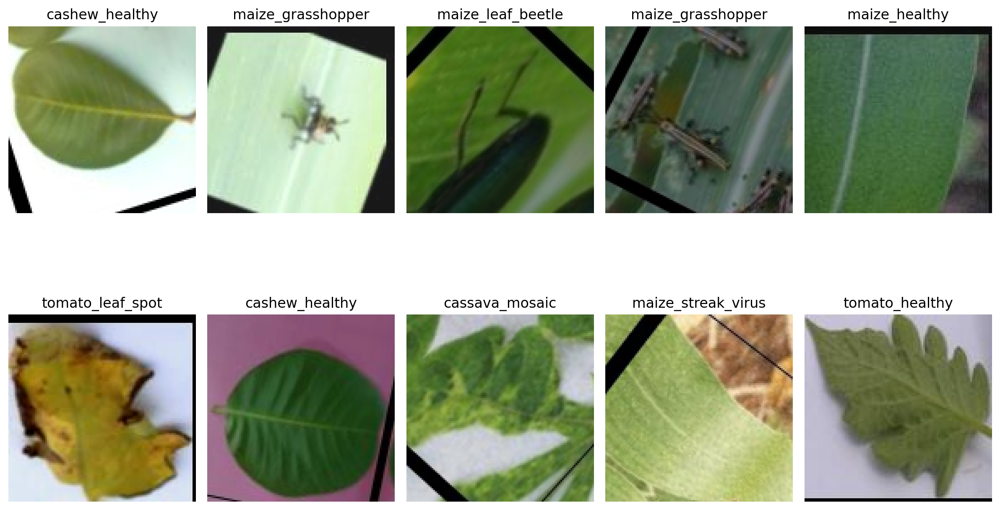

In [37]:
import matplotlib.pyplot as plt
%matplotlib inline

def visualize_augmentations(dataset, idx=0, samples=10, cols=5, random_img = False):
    
    dataset = copy.deepcopy(dataset)
    #we remove the normalize and tensor conversion from our augmentation pipeline
    dataset.transform = A.Compose([t for t in dataset.transform if not isinstance(t, (A.Normalize, ToTensorV2))])
    rows = samples // cols
    
        
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(12, 8))
    for i in range(samples):
        if random_img:
            idx = np.random.randint(1,len(train_image_paths))
        image, lab = dataset[idx]
        ax.ravel()[i].imshow(image)
        ax.ravel()[i].set_axis_off()
        ax.ravel()[i].set_title(idx_to_class[lab])
    plt.tight_layout(pad=1)
    plt.show()    

visualize_augmentations(train_dataset,np.random.randint(1,len(train_image_paths)), random_img = True)

# Neural Magic Integration

In [38]:
# import os
# import shutil
# # Folder to be removed
# folder_to_remove = '/kaggle/working/model'

# if os.path.exists(folder_to_remove):
#     shutil.rmtree(folder_to_remove)
#     print(f'Removed folder: {folder_to_remove}')
# else:
#     print(f'Folder not found: {folder_to_remove}')

In [39]:
!env/bin/pip install sparseml[torch,torchvision] sparsezoo
clear_output()

In [40]:
import sparseml
from sparsezoo import search_models
"""
    Obtains a list of Models matching the search parameters
    :param domain: The domain of the model the object belongs to;
        e.g. cv, nlp
    :param sub_domain: The sub domain of the model the object belongs to;
        e.g. classification, segmentation
    :param architecture: The architecture of the model the object belongs to;
        e.g. resnet_v1, mobilenet_v1
    :param sub_architecture: The sub architecture (scaling factor) of the model
        the object belongs to; e.g. 50, 101, 152
    :param framework: The framework the model the object belongs to was trained on;
        e.g. pytorch, tensorflow
    :param repo: The source repo for the model the object belongs to;
        e.g. sparseml, torchvision
    :param dataset: The dataset the model the object belongs to was trained on;
        e.g. imagenet, cifar10
    :param training_scheme: The training scheme used on the model the object
        belongs to if any; e.g. augmented
    :param sparse_name: The name describing the sparsification of the model
        the object belongs to, e.g. base, pruned, pruned_quant
    :param sparse_category: The degree of sparsification of the model the object
        belongs to; e.g. none, conservative (~100% baseline metric),
        moderate (>=99% baseline metric), aggressive (<99% baseline metric)
    :param sparse_target: The deployment target of sparsification of the model
        the object belongs to; e.g. edge, deepsparse, deepsparse_throughput, gpu
    :param release_version: The sparsezoo release version for the model
    :param page: the page of values to get
    :param page_length: the page length of values to get
    :param override_folder_name: Override for the name of the folder to save
        this file under
    :param override_parent_path: Path to override the default save path
        for where to save the parent folder for this file under
    :param force_token_refresh: True to refresh the auth token, False otherwise
    :param return_stubs: if True, found models will be returned as stubs only
        instead of retrieving full info for each found model. Default False
    :return: The requested list of Model instances
"""
args = {
    "domain": "cv",
    "sub_domain": "classification",
    "architecture": "efficientnet_v2",
    "dataset": "imagenet"
}

models = search_models(**args)
[print(model) for model in models]

2024-08-10 17:24:49.702852: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-10 17:24:49.702977: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-10 17:24:49.822766: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Model(stub=zoo:efficientnet_v2-l-imagenet-base)
Model(stub=zoo:efficientnet_v2-m-imagenet-base)
Model(stub=zoo:efficientnet_v2-s-imagenet-base)
Model(stub=zoo:efficientnet_v2-s-imagenet-base_quantized)


[None, None, None, None]

In [41]:
from sparsezoo import Model

stub = "zoo:efficientnet_v2-s-imagenet-base_quantized"
download_directory = '/kaggle/working/model'

zoomodel = Model(stub, download_path = download_directory)

## Download model

In [42]:
# zoomodel.download()

In [43]:
zoomodel.available_files

{'training': Directory(name=training),
 'deployment': Directory(name=deployment),
 'sample_inputs': Directory(name=sample-inputs.tar.gz),
 'sample_outputs': {'framework': Directory(name=sample-outputs.tar.gz)},
 'sample_labels': Directory(name=sample-labels.tar.gz),
 'model_card': File(name=model.md),
 'recipes': <sparsezoo.objects.recipes.Recipes at 0x7c4f4de99330>,
 'onnx_model': OnnxGz(name=model.onnx.tar.gz, path=None),
 'benchmark': File(name=benchmark.yaml),
 'metrics': File(name=metrics.yaml)}

In [44]:
print(f"File name: {zoomodel.onnx_model.name}\n"
      f"File path: {zoomodel.onnx_model.path}\n"
      f"File URL: {zoomodel.onnx_model.url}\n"
      f"Parent directory: {zoomodel.onnx_model.parent_directory}")
print(str(zoomodel))

File name: model.onnx.tar.gz
File path: /kaggle/working/model/model.onnx
File URL: https://api.neuralmagic.com/v2/models/efficientnet_v2-s-imagenet-base_quantized/files/model.onnx.tar.gz?version=2
Parent directory: /kaggle/working/model
Model(stub=zoo:efficientnet_v2-s-imagenet-base_quantized)


## Configuring model

**Accessing recipes**

In [45]:
available_recipes = zoomodel.recipes.available
print(available_recipes)
# Accessing the default recipe
original_recipe = zoomodel.recipes.default
original_recipe_path = original_recipe.path # This downloads the recipe and returns its path
print(f"Default recipe path: {original_recipe_path}")

['recipe', 'recipe_transfer_classification']
Default recipe path: /kaggle/working/model/recipe.md


**Inspecting Recipe**
```
version: 1.1.0

# General Variables
num_epochs: 10.0

qat_start_epoch: 0.0
qat_epochs: 3.0
qat_end_epoch: eval(qat_start_epoch + qat_epochs)

ft_epochs: 1

init_lr: 5.5e-5
min_lr: 1e-8

weight_decay: 0.00001

qat_disable_observer_epoch: eval(qat_end_epoch)
qat_freeze_bn_epoch: eval(qat_end_epoch)

distill_hardness: 0.9
distill_temperature: 5.0

# Modifiers

training_modifiers:
 - !EpochRangeModifier
     start_epoch: 0
     end_epoch: eval(num_epochs)

 - !SetLearningRateModifier
     start_epoch: 0.0
     learning_rate: eval(init_lr)

 - !LearningRateFunctionModifier
     start_epoch: eval(qat_start_epoch)
     end_epoch: eval(qat_end_epoch)
     lr_func: cosine
     init_lr: eval(init_lr)
     final_lr: eval(min_lr)

 - !LearningRateFunctionModifier
     start_epoch: eval(qat_end_epoch)
     end_epoch: eval(qat_end_epoch + ft_epochs)
     lr_func: cosine
     init_lr: eval(init_lr)
     final_lr: eval(min_lr)

 - !LearningRateFunctionModifier
     start_epoch: eval(qat_end_epoch + ft_epochs)
     end_epoch: eval(qat_end_epoch + 4 * ft_epochs)
     lr_func: cosine
     init_lr: eval(init_lr)
     final_lr: eval(min_lr)

quantization_modifiers:
 - !QuantizationModifier
     start_epoch: eval(qat_start_epoch)
     ignore:
     - classifier
     - AdaptiveAvgPool2d
     disable_quantization_observer_epoch: eval(qat_end_epoch)
     freeze_bn_stats_epoch: eval(qat_end_epoch)

distillation_modifiers:
 - !DistillationModifier
     hardness: eval(distill_hardness)
     temperature: eval(distill_temperature)
     distill_output_keys: [0]

regularization_modifiers:
 - !SetWeightDecayModifier
     start_epoch: 0
     weight_decay: eval(weight_decay)
```
The *Modifiers* in the transfer learning recipe are the important items that encode how SparseML should modify the training process for Sparse Transfer Learning:
* The *EpochRangeModifier* controls the range of epochs for training a model. Each supported ML framework has an implementation to enable easily retrieving this number of epochs. 
* The *SetLearningRateModifier* sets the learning rate (LR) for the optimizer to a specific value at a specific point in the training process.
* *ConstantPruningModifier* tells SparseML to pin weights at 0 over all epochs, maintaining the sparsity structure of the network
* *QuantizationModifier* tells SparseML to quanitze the weights with quantization aware training over the last 3 epochs


To transfer learn this sparsified model to other datasets you may have to adjust certain hyperparameters in this recipe and/or training script. Some considerations:

For more complex datasets, increase the number of epochs, adjusting the learning rate step accordingly
* Adding more learning rate step milestones can lead to more jumps in accuracy
* Increase the learning rate when increasing batch size
* Increase the number of epochs if using SGD instead of the Adam optimizer
* Update the base learning rate based on the number of steps needed to train your dataset

[Recipes Documentation](https://github.com/neuralmagic/sparseml/blob/main/docs/source/recipes.md)

In [46]:
# import re

# # Define the path to your markdown file
# file_path = original_recipe_path

# # Step 1: Read the content of the file
# with open(file_path, 'r') as file:
#     content = file.read()

# # Print the original content of the file
# print("Original Content:\n", content)
# clear_output()


In [47]:
# content = """
# <!--
# Copyright (c) 2023 - present / Neuralmagic, Inc. All Rights Reserved.

# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at

#    http://www.apache.org/licenses/LICENSE-2.0

# Unless required by applicable law or agreed to in writing,
# software distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# -->

# ---
# version: 1.1.0

# # General Variables
# num_epochs: 10.0

# qat_start_epoch: 0.0
# qat_epochs: 3.0
# qat_end_epoch: eval(qat_start_epoch + qat_epochs)

# ft_epochs: 1

# init_lr: 5.5e-5
# min_lr: 1e-8

# weight_decay: 0.00001

# qat_disable_observer_epoch: eval(qat_end_epoch)
# qat_freeze_bn_epoch: eval(qat_end_epoch)

# distill_hardness: 0.9
# distill_temperature: 5.0

# # Modifiers

# training_modifiers:
#  - !EpochRangeModifier
#      start_epoch: 0
#      end_epoch: eval(num_epochs)

#  - !SetLearningRateModifier
#      start_epoch: 0.0
#      learning_rate: eval(init_lr)

#  - !LearningRateFunctionModifier
#      start_epoch: eval(qat_start_epoch)
#      end_epoch: eval(qat_end_epoch)
#      lr_func: cosine
#      init_lr: eval(init_lr)
#      final_lr: eval(min_lr)

#  - !LearningRateFunctionModifier
#      start_epoch: eval(qat_end_epoch)
#      end_epoch: eval(qat_end_epoch + ft_epochs)
#      lr_func: cosine
#      init_lr: eval(init_lr)
#      final_lr: eval(min_lr)

#  - !LearningRateFunctionModifier
#      start_epoch: eval(qat_end_epoch + ft_epochs)
#      end_epoch: eval(qat_end_epoch + 4 * ft_epochs)
#      lr_func: cosine
#      init_lr: eval(init_lr)
#      final_lr: eval(min_lr)

# quantization_modifiers:
#  - !QuantizationModifier
#      start_epoch: eval(qat_start_epoch)
#      ignore:
#      - classifier
#      - AdaptiveAvgPool2d
#      disable_quantization_observer_epoch: eval(qat_end_epoch)
#      freeze_bn_stats_epoch: eval(qat_end_epoch)

# distillation_modifiers:
#  - !DistillationModifier
#      hardness: eval(distill_hardness)
#      temperature: eval(distill_temperature)
#      distill_output_keys: [0]

# regularization_modifiers:
#  - !SetWeightDecayModifier
#      start_epoch: 0
#      weight_decay: eval(weight_decay)

# ---

# # EfficientNet_v2-s Quantized on the Imagenet dataset

# This recipe defines the hyperparams necessary to quantize the Efficient_v2-s model, which was originally trained through and available via [Torchvision](https://pytorch.org/vision/stable/models/generated/torchvision.models.efficientnet_v2_s.html). This resulting model achieves 83.47% top-1 and 96.58% top-5 accuracy on the validation set.

# Users are encouraged to experiment with the hyperparams such as training length and learning rates to either expedite training or to produce a more accurate model.
# This can be done by either editing the recipe or supplying the --recipe_args argument to the training commands.
# For example, the following appended to the training commands will change the number of epochs and the initial learning rate:
# ```bash
# --recipe_args '{"num_epochs":8,"init_lr":0.0001}'
# ```

# ## Training
# To set up the training environment, [install SparseML with PyTorch](https://github.com/neuralmagic/sparseml#installation)

# The following command was used to quantize the Efficient_v2-s model on the ImageNet dataset using four GPUs A100.

# ```bash
# python -m torch.distributed.run --nproc_per_node 4 --no_python sparseml.image_classification.train \
#     --checkpoint-path zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base-none \
#     --arch-key efficientnet_v2_s \
#     --output-dir quantized_efficientnet_v2_s \
#     --recipe zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base_quant-none \
#     --teacher-arch-key efficientnet_v2_s \
#     --distill-teacher zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base-none \
#     --pretrained-teacher-dataset imagenet \
#     --dataset-path /PATH/TO/DATASET \
#     --opt rmsprop \
#     --batch-size 32 \
#     --gradient-accum-steps 5 \
#     --auto-augment imagenet \
#     --random-erase 0.1 \
#     --label-smoothing 0.1 \
#     --mixup-alpha 0.2 \
#     --cutmix-alpha 1.0 \
#     --norm-weight-decay 0.0 \
#     --train-crop-size 300 \
#     --model-ema \
#     --val-crop-size 384 \
#     --val-resize-size 384 \
#     --ra-sampler \
#     --ra-reps 4 \
#     --workers 16 \
#     --logging_steps 200 \
#     --eval_steps 400
# ```

# ## Evaluation

# This model achieves 83.47% top-1 and 96.58% top-5 accuracy on the validation set. The following command can be used to verify accuracy.

# ```bash
# sparseml.image_classification.train \
#     --checkpoint-path zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base_quant-none \
#     --arch-key efficientnet_v2_s \
#     --test-only \
#     --dataset-path /PATH/TO/IMAGENET \
#     --val-crop-size 384 \
#     --val-resize-size 384 \
#     --batch-size 64
# ```

# """

# # Write the updated content back to the file
# with open(file_path, 'w') as file:
#     file.write(content)

# # Print a confirmation message
# print("Updated successfully!")


**Accessing Checkpoints**:

In general, we are expecting the following checkpoints to be included in the model:

* checkpoint_prepruning
* checkpoint_postpruning
* checkpoint_preqat
* checkpoint_postqat

The checkpoint that the model defaults to is the preqat state (just before the quantization step).

In [48]:
available_checkpoints = zoomodel.training.available
print(available_checkpoints)
preqat_checkpoint = zoomodel.training.default # recipe defaults to `preqat`
preqat_checkpoint_path = preqat_checkpoint.path # downloads the checkpoint and returns its path
print(preqat_checkpoint_path)
[print(file.name) for file in preqat_checkpoint.files]

['preqat']
/kaggle/working/model/training
training/checkpoint_preqat/model.pth
training/imagenet-training-metric.yaml
training/model.pth


[None, None, None]

### Downloading Model locally

In [49]:
# import shutil
# from IPython.display import FileLink

# # Define the directory you want to zip
# folder_to_zip = '/kaggle/working/model'
# zip_filename = '/kaggle/working/model.zip'

# # Create a zip archive of the folder
# shutil.make_archive(zip_filename.replace('.zip', ''), 'zip', folder_to_zip)

# # Create a downloadable link
# FileLink(zip_filename)


# Model Setup

In [50]:
from sparseml.pytorch.models import ModelRegistry
ZOO_STUB = "zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base_quant-none?recipe_type=transfer-classification"
# SparseZoo stub to pre-trained sparse-quantized EfficientNetV2s for imagenet dataset
model = ModelRegistry.create(
    key="efficientnet_v2_s",
    pretrained_path=ZOO_STUB,
    pretrained_dataset="imagenet",
    num_classes=22,
    ignore_error_tensors=["classifier.fc.weight", "classifier.fc.bias"],
)
input_shape = ModelRegistry.input_shape("efficientnet_v2_s")
input_size = input_shape[-1]
num_classes = 22

Combining Chunks: 100%|██████████| 86.7M/86.7M [00:00<00:00, 627MB/s]


## Metrics: loss and optimizers

In [51]:
from torch.nn import CrossEntropyLoss
from torch.optim import Adam

# hyperparameters
BATCH_SIZE = 64

# setup device
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
print(f"Using device: {device}")

# setup loss function and optimizer, LR will be overriden by sparseml
criterion = CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=8e-3)

Using device: cuda


In [52]:
# num_epochs: 10.0

# qat_start_epoch: 0.0
# qat_epochs: 3.0
# qat_end_epoch: eval(qat_start_epoch + qat_epochs)

# ft_epochs: 1

# init_lr: 5.5e-5
# min_lr: 1e-8

# weight_decay: 0.00001

# qat_disable_observer_epoch: eval(qat_end_epoch)
# qat_freeze_bn_epoch: eval(qat_end_epoch)

# distill_hardness: 0.9
# distill_temperature: 5.0
hyper_params = {"BATCH_SIZE" : BATCH_SIZE, "Inital Learning Rate": 5.5e-5, "Minimum Learning Rate": 1e-8, "Optimizer" : "Adam", "Loss": "Cross Entropy",
                "Epochs":10, "Quantization Epochs": 3, "Weight Decay": 0.00001, "Distill Hardness": 0.9, "Distill Temperature": 5.0, "Device": device}

## DataLoaders

This helps us processing data in mini-batches that can fit within our GPU’s RAM. 

In [53]:
from torch.utils.data import DataLoader
train_loader = DataLoader(
    train_dataset, BATCH_SIZE, shuffle=True, pin_memory=True, num_workers=4
)

val_loader = DataLoader(
    val_dataset, BATCH_SIZE, shuffle=True, pin_memory=True, num_workers=4
)

test_loader = DataLoader(
    test_dataset, BATCH_SIZE, shuffle=False, pin_memory=True, num_workers=4
)

In [54]:
# data loaders have iterable batches of [[list of tensors], [list of labels]]
#batch of image tensor
print(next(iter(train_loader))[0].shape)
#batch of corresponding labels
print(next(iter(train_loader))[1].shape)

/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


torch.Size([64, 3, 112, 112])
torch.Size([64])


## Model Architecture

In [ ]:
# !/kaggle/working/env/bin/pip install torchinfo
from torchinfo import summary
model_stats = summary(model, input_size=(BATCH_SIZE, 3, 112, 112), depth=4)
summary_str = str(model_stats)
print(model_stats)

# Comet Integration

In [ ]:
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
cmt_api_key = user_secrets.get_secret("COMET_API_KEY")

In [ ]:
import comet_ml
from comet_ml import Experiment
from comet_ml.integration.pytorch import log_model, watch
clear_output()

In [ ]:
# Setting comet parameters
os.environ["COMET_MAX_IMAGE_PREDICTIONS"] = "200" #By default Comet will log 100 image predictions from the validation set.
os.environ["COMET_LOGGING_HIDE_API_KEY"] = "true"
os.environ["COMET_AUTO_LOG_CODE"] = "true"
os.environ["COMET_AUTO_LOG_PARAMETERS"] = "true"
os.environ["COMET_AUTO_LOG_GRAPH"] = "true"
os.environ["COMET_AUTO_LOG_METRICS"] = "true"
os.environ["COMET_AUTO_LOG_ENV_DETAILS"] = "true"
os.environ["COMET_AUTO_LOG_ENV_GPU"] = "false"
os.environ["COMET_AUTO_LOG_ENV_CPU"] = "false"
# os.environ['COMET_EVAL_BATCH_LOGGING_INTERVAL'] = "4" # By default it is set to 1, which corresponds to logging predictions from every validation batch, here every 4th batch
# os.environ["COMET_EVAL_LOG_CONFUSION_MATRIX"] = "false" #By default true: logged after every epoch, false will log only in end
# os.environ["COMET_MODE"] = "offline" #In case you are in a situation where you are using a machine without public internet acces,  run will be saved locally in a directory that you can upload to Comet.

# Load a model
# model = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)

In [ ]:
# #For new project
# import comet_ml

# comet_ml.init(project_name="new_project-name")

**Log automatically**

---



Comet automatically logs the following data, with no additional configuration:

* Model and graph description
* Training loss

In [ ]:
# # New experiment
# experiment = Experiment(
#   api_key=cmt_api_key,
#   project_name="pest-detection",
#   workspace="parserpixy"
# )

# Resuming existing experiment

comet_ml.login()

experiment = comet_ml.ExistingExperiment(
    experiment_key="60f313a4ad8d464a87e2c165653039cd",
    api_key=cmt_api_key,
    log_code=True,
    log_graph=True,
    log_env_details=False,
    log_env_gpu=False,
    log_env_cpu=False,
    auto_param_logging=True,
    auto_metric_logging=True
)
watch(model)

In [ ]:
print(experiment.url)

In [ ]:
#Initial logs
# experiment.add_tags(['Classification','CCMT','efficientnet_v2-s-imagenet-base_quantized'])
# experiment.log_model("Initial model", '/kaggle/working/model/model.onnx',"Pretrained EfficientNetV2 on ImageNet")
# experiment.log_parameters(hyper_params, nested_support=True)
# experiment.log_text(summary_str)

# Training using sparseml

## Training Loop and Objects

In [ ]:
import torch
from tqdm.auto import tqdm
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

def run_model_one_epoch(model, data_loader, criterion, device, num_classes, train=False, optimizer=None):
    if train:
        model.train()
    else:
        model.eval()

    running_loss = 0.0
    total_correct = 0
    total_predictions = 0
    
    all_labels = []
    all_predictions = []
    all_probabilities = []

    # Loop through batches
    for step, (inputs, labels) in tqdm(enumerate(data_loader), total=len(data_loader)):
        inputs = inputs.to(device)
        labels = labels.to(device)

        if train:
            optimizer.zero_grad()

        # Compute loss, run backpropagation
        outputs, _ = model(inputs)  # model returns logits and softmax as a tuple
        probabilities = torch.softmax(outputs, dim=1)  # Calculate probabilities
        loss = criterion(outputs, labels)
        if train:
            loss.backward()
            optimizer.step()

        running_loss += loss.item()

        # Run evaluation
        predictions = outputs.argmax(dim=1)
        total_correct += torch.sum(predictions == labels).item()
        total_predictions += inputs.size(0)

        # Collect predictions and labels for metrics calculation
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predictions.cpu().numpy())
        all_probabilities.extend(probabilities.detach().cpu().numpy())

    # Convert to numpy arrays for metric calculations
    all_labels = np.array(all_labels)
    all_predictions = np.array(all_predictions)
    all_probabilities = np.array(all_probabilities)

    # Calculate metrics
    loss = running_loss / (step + 1.0)
    accuracy = total_correct / total_predictions
    precision = precision_score(all_labels, all_predictions, average='weighted')
    recall = recall_score(all_labels, all_predictions, average='weighted')
    f1 = f1_score(all_labels, all_predictions, average='weighted')

    # Calculate AUC-ROC for multiclass
    auc_roc = roc_auc_score(all_labels, all_probabilities, multi_class='ovr', average='weighted')

    # Calculate confusion matrix
    conf_matrix = confusion_matrix(all_labels, all_predictions)

    return loss, accuracy, precision, recall, f1, auc_roc, conf_matrix

# Example usage:
# loss, accuracy, precision, recall, f1, auc_roc, conf_matrix = run_model_one_epoch(model, data_loader, criterion, device, num_classes, train=True, optimizer=optimizer)


In [ ]:
# !env/bin/sparseml.image_classification.train \
#   --checkpoint-path zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base_quant-none?recipe_type=transfer-classification \
#   --recipe zoo:cv/classification/efficientnet_v2-s/pytorch/sparseml/imagenet/base_quant-none?recipe_type=transfer-classification \
#   --recipe_args '{"num_epochs":15"}' \
#   --arch-key efficientnet_v2_s \
#   --dataset-path /kaggle/working/data \
#   --opt rmsprop \
#   --batch-size 64 \
#   --auto-augment imagenet \
#   --random-erase 0.1 \
#   --label-smoothing 0.1 \
#   --mixup-alpha 0.2 \
#   --cutmix-alpha 1.0 \
#   --weight-decay 0.00002 \
#   --norm-weight-decay 0.0 \
#   --train-crop-size 640 \
#   --model-ema \
#   --val-crop-size 640 \
#   --val-resize-size 640 \
#   --ra-sampler \
#   --ra-reps 4 \
#   --workers 4

## Run Training

Using SparseML's *ScheduledModifierManager* to parse the instructions from the recipes and update the optimizer and model with the instructions encoded therein.

In [ ]:
from sparseml.pytorch.optim import ScheduledModifierManager

# create ScheduledModifierManager and Optimizer wrapper
manager = ScheduledModifierManager.from_yaml(original_recipe_path)
optimizer = manager.modify(model, optimizer, steps_per_epoch=len(train_loader))

We pass the *modified model* and optimizer objects to the training loop we build above. Since we already called *manager.modify* all of the logic from the recipe is encoded in the optimizer and model. We can use the model and optimizer, and the SparseML system applies the algorithms specified in the recipe. In this case, since we applied a *ConstantPruningModifier*, the weights which are zero will be pinned to 0 during the fine-tuning, maintaining the sparsity structure as the model fine-tunes.

In [ ]:
# run transfer learning
# model, data_loader, criterion, device, num_classes, train=False, optimizer=None
# epoch = manager.min_epochs
start_epoch = 10
end_epoch = 15
for epoch in range(start_epoch, manager.max_epochs):
    
    with experiment.train():
        # run training loop
        epoch_name = f"{epoch + 1}/{manager.max_epochs}"
        print(f"Running Training Epoch {epoch_name}")
        train_loss, train_acc, train_prec, train_rcl, train_f1, train_auc, train_cm = run_model_one_epoch(
            model, train_loader, criterion, device, num_classes, train=True, optimizer=optimizer
        )
        print(
            f"Training Epoch: {epoch_name}\nTraining Loss: {train_loss}\nTop 1 Acc: {train_acc}\n"
        )
        #logging metrics
        train_metrics = {"train_loss": train_loss, "train_Accuracy": train_acc, "train_Precision": train_prec, "train_Recall" : train_rcl, "train_F1_Score" : train_f1, "train_AUC_Score": train_auc}
        experiment.create_confusion_matrix(matrix=train_cm, title="Training Confusion Matrix", max_examples_per_cell=300)
        experiment.log_metrics(train_metrics, epoch=epoch)
manager.finalize(model)

In [ ]:
# torch.save(model.state_dict(), '/kaggle/working/model.pt')
# the_model = TheModelClass(*args, **kwargs)
# model.load_state_dict(torch.load('/kaggle/working/model.pt'))

In [ ]:
# experiment.log_model("Trained model", '/kaggle/working/model.pt',"Trained for 10 epochs")

## Run Validation

In [ ]:
epoch = manager.min_epochs
for epoch in range(manager.max_epochs):
    with experiment.validate():    
        # run validation loop
        print(f"Running Validation Epoch {epoch}")
        val_loss, val_acc, val_prec, val_rcl, val_f1, val_auc, val_cm = run_model_one_epoch(model, val_loader, criterion, device, num_classes)
        print(
            f"Validation Epoch: {epoch}\nVal Loss: {val_loss}\nTop 1 Acc: {val_acc}\n"
        )
        #logging metrics
        val_metrics = {"valid_loss": val_loss, "valid_Accuracy": val_acc, "valid_Precision": val_prec, "valid_Recall": val_rcl, "valid_F1_Score" : val_f1, "valid_AUC_Score": val_auc}
        experiment.create_confusion_matrix(matrix=val_cm, title="Validation Confusion Matrix", max_examples_per_cell=300)
        experiment.log_metrics(val_metrics, epoch=epoch)

# Post Processing

***Layerwise sparsity structure of the network***

In [ ]:
from sparseml.pytorch.utils import get_prunable_layers, tensor_sparsity

# print sparsities of each layer
for (name, layer) in get_prunable_layers(model):
    print(f"{name}.weight: {tensor_sparsity(layer.weight).item():.4f}")

***Exporting to ONNX***

In [ ]:
from sparseml.pytorch.utils import ModuleExporter
# !mkdir /kaggle/working/export
save_dir = "/kaggle/working/export"
exporter = ModuleExporter(model, output_dir=save_dir)
exporter.export_pytorch(name="efficientnet_v2_imagenet_pruned_quantized.pth")
exporter.export_onnx(torch.randn(1, 3, 112, 112), name="effv2_pq.onnx", convert_qat=True)

# Inference with Deepsparse

In [8]:
!source /kaggle/working/env/bin/activate
!pip install deepsparse
clear_output()

In [58]:
from deepsparse import Pipeline
from PIL import Image
import torch
from torch.utils.data import DataLoader
from torchvision.transforms import ToPILImage
import matplotlib.pyplot as plt

# Initialize the pipeline
ic_pipeline = Pipeline.create(
    task="image_classification",
    model_path="/kaggle/working/export/effv2_pq.onnx",
    batch_size=BATCH_SIZE,  # Set batch size; can be None for dynamic batch size
)

2024-08-10 17:29:59 deepsparse.image_classification.pipeline WARNING  Updating engine_kwargs to include /kaggle/working/export/effv2_pq.onnx
2024-08-10 17:30:08 deepsparse.routers.router WARNING  SPLIT and JOIN are not yet supported for the LinearRouter.


**Using TestLoader for Test Images** (Augmented)

labels=[[14], [13], [4], [14], [13], [14], [11], [1], [10], [11], [1], [4], [4], [15], [4], [11], [14], [4], [14], [4], [10], [4], [13], [13], [10], [13], [14], [10], [14], [14], [13], [2], [14], [5], [11], [1], [14], [3], [2], [16], [13], [11], [13], [14], [4], [2], [15], [14], [4], [2], [14], [16], [11], [15], [13], [1], [11], [14], [2], [2], [16], [14], [11], [10]] scores=[[5.087664604187012], [2.8441410064697266], [4.552949905395508], [3.992042064666748], [1.375334620475769], [3.2522130012512207], [10.391849517822266], [2.9845998287200928], [1.8873437643051147], [3.01625394821167], [4.812204837799072], [3.143425703048706], [5.137197971343994], [2.686568260192871], [2.7408978939056396], [2.9294016361236572], [6.789725303649902], [1.7286901473999023], [2.025299549102783], [4.611062526702881], [3.150346517562866], [4.111398220062256], [3.663665294647217], [2.7210230827331543], [3.5314724445343018], [6.966334819793701], [2.3037989139556885], [3.726433277130127], [4.637938022613525], [3

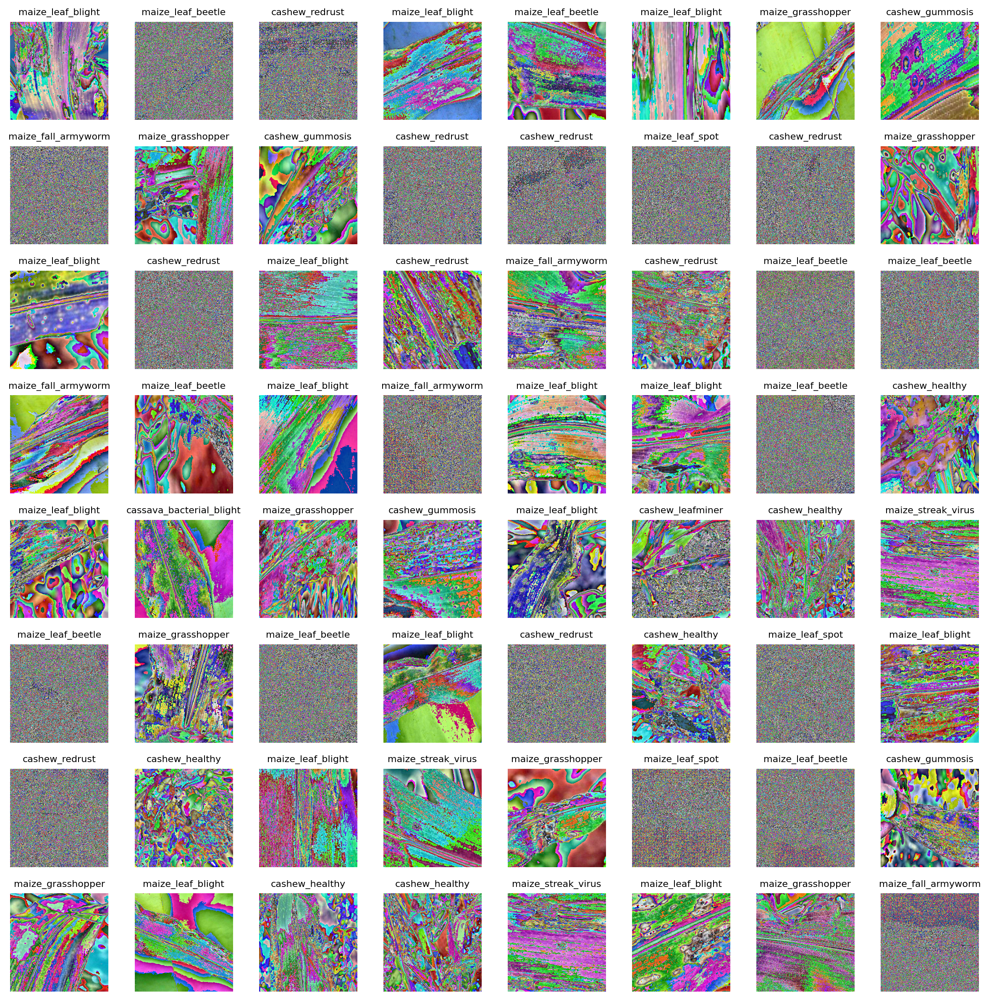

In [66]:
# Convert a tensor to a PIL image
to_pil_image = ToPILImage()

# Get the first batch of image tensors
batch = next(iter(test_loader))[0]  # batch[0] is the list of image tensors

# Convert tensors to PIL images
images = [to_pil_image(img_tensor) for img_tensor in batch]

# Pass the batch of images to the pipeline
results = ic_pipeline(images=images)

# results = [[nested list of labels], [nested list of scores]]

print(results)
# Extract the predicted labels
predicted_labels = [label[0] for label in results.labels]

# Plot the images in an 8x8 grid
plt.figure(figsize=(12, 12))
for i in range(len(images)):
    plt.subplot(8, int(BATCH_SIZE/8) , i + 1)
    plt.imshow(images[i])
    plt.title(idx_to_class.get(predicted_labels[i]), fontsize=8) # Printing respective class labels as titles
    plt.axis('off')

plt.tight_layout()
plt.show()


**Using Normal Test Images**

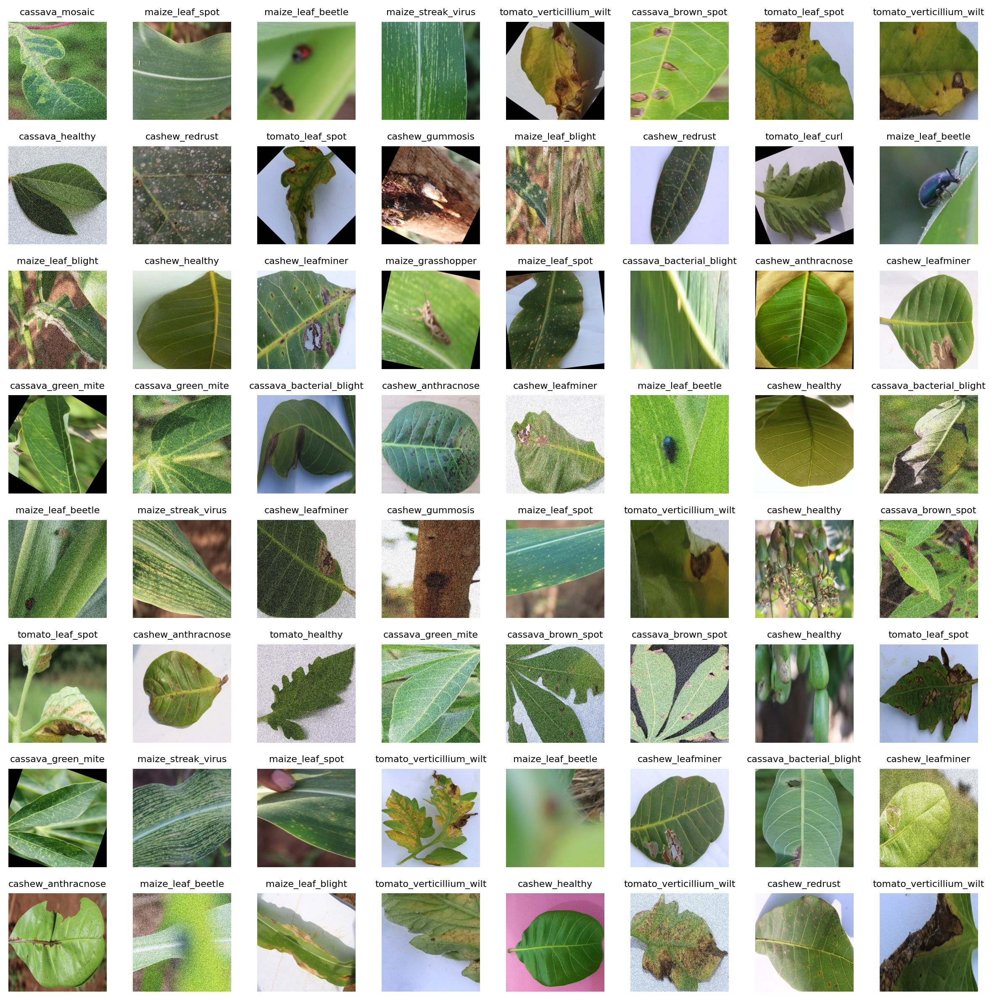

In [69]:
selected_image_paths = random.sample(test_image_paths, BATCH_SIZE)
# Load and convert selected images to PIL format
images = [Image.open(path).convert("RGB") for path in selected_image_paths]

# Pass the batch of images to the pipeline
results = ic_pipeline(images=images)

# Extract the predicted labels from the results
predicted_labels = [label[0] for label in results.labels]  # Flatten the nested lists

# Plot the images in an 8x8 grid
plt.figure(figsize=(12, 12))
for i in range(len(images)):
    plt.subplot(8, int(BATCH_SIZE/8), i + 1)
    plt.imshow(images[i])
    plt.title(idx_to_class.get(predicted_labels[i]), fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# For ending comet logs
# experiment.end()